# EDA

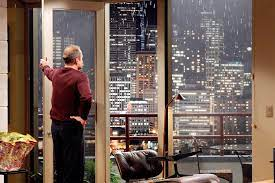

In [71]:
import warnings

warnings.filterwarnings("ignore")

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import geojson
import plotly.express as px
import plotly.graph_objs as go



from matplotlib.ticker import PercentFormatter
plt.rcParams.update({ "figure.figsize" : (8, 5),"axes.facecolor" : "white", "axes.edgecolor":  "black"})
plt.rcParams["figure.facecolor"]= "w"
pd.plotting.register_matplotlib_converters()
pd.set_option('display.float_format', lambda x: '%.3f' % x)

In [ ]:
pd.set_option('max_column', None)


In [13]:
original = pd.read_csv('data/details_sales.csv')
original.sample(5)

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date,price,house_id,id.1
18094,8898701340,3.000,2.500,1190.000,8175.000,1.000,0.000,0.000,3,7,...,0.000,98055,47.456,-122.203,2230.000,9520.000,2014-10-29,290000.000,8898701340,18095
13130,8567450180,5.000,2.500,2630.000,9216.000,2.000,0.000,0.000,3,8,...,0.000,98019,47.738,-121.966,2020.000,4980.000,2014-05-29,525000.000,8567450180,13131
11737,7715800390,3.000,2.250,1520.000,14080.000,2.000,0.000,0.000,3,7,...,0.000,98074,47.627,-122.059,1530.000,9758.000,2014-11-10,447000.000,7715800390,11738
1132,7135520810,4.000,4.000,4390.000,17832.000,1.000,0.000,0.000,4,11,...,0.000,98059,47.528,-122.143,3090.000,12369.000,2014-07-30,1280000.000,7135520810,1133
15810,1061500630,5.000,2.750,2790.000,7600.000,1.500,0.000,0.000,4,7,...,0.000,98056,47.500,-122.165,1480.000,7600.000,2015-02-05,359900.000,1061500630,15811


## Data Analysis

Understand your data.

|**Column Names**   |  **Description** |
|---                |---:               |
| id                | unique identified for a house  | 
| dateDate              | date the house was sold  |
| pricePrice             | price for each house  |
| bedroomsNumber          | number of bedrooms  |
| bathroomsNumber         | number of bathrooms,  where .5 stands for a room with a toilet but no shower  |
| sqft_livingsquare       | square footage of the house’s interior living space  |
| sqft_lotsquare          | square footage of the land space   |
| floors            | number of floors  |
| waterfront        | Has the house on the water view? 0-No 1-Yes  |
| view              | An index from 0 to 4 indicating how good the survey of the property was  |
| condition         | An index from 1 to 5 for the condition of the flat,1 - lowest, 5 - highest  |
| grade             |  An index of 1 to 13, where 1-3 lags behind construction and design of buildings, 7 shows an average level of construction and design and 11-13 shows a high level of quality of construction and design. |
| sqft_above        | square feet above ground |
| sqft_basement     | square footage of the basement  |
| yr_built          | The year in which the house was originally built |
| yr_renovated      | The year of the last renovation of the house   |
| zipcode           | In which zipcode area is the house located  |
| lat               | latitude  |
| long              | logitude  |
| sqft_living15     | average size of interior housing living space for the closest 15 houses, in square feet  |
| sqft_lot15        | average size of land lot for the closest 15 houses, in square feet  |

 To get an overview of the data and check the quality of the data we will be answering the following questions beforehand:
- How many house sales are in our data set?
- What datatypes do we have? 
- Are there missing values? 
- Which columns are continuous or categorical?
- How many categories we have in the seperate features?


**1. How many house sales are in our data set?**

In [14]:
original.shape

(21597, 23)

We have 21597 rows of data of which each row represents a sale. It is not excluded that in case of different sales, it can still be the same house.

**2. What datatypes do we have? Should some of them be changed for further investigation?**

In [15]:
original.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21597 non-null  int64  
 1   bedrooms       21597 non-null  float64
 2   bathrooms      21597 non-null  float64
 3   sqft_living    21597 non-null  float64
 4   sqft_lot       21597 non-null  float64
 5   floors         21597 non-null  float64
 6   waterfront     19206 non-null  float64
 7   view           21534 non-null  float64
 8   condition      21597 non-null  int64  
 9   grade          21597 non-null  int64  
 10  sqft_above     21597 non-null  float64
 11  sqft_basement  21145 non-null  float64
 12  yr_built       21597 non-null  int64  
 13  yr_renovated   17749 non-null  float64
 14  zipcode        21597 non-null  int64  
 15  lat            21597 non-null  float64
 16  long           21597 non-null  float64
 17  sqft_living15  21597 non-null  float64
 18  sqft_l

We have only integer and float datatypes except for 1 Object.

The datatypes of the following columns should be investigated:
- view
- grade
- condition
- date (This ons should be changed from object to datetime)
- zipcode
- waterfront


**3. Are there missing Values?**

In [16]:
# Function to see how many NaN values there are in the column and how many rows have the entry 0 in these columns.  It should help to facilitate the action of deleting them or filling them with zero if necessary.
def missing_values_table(df):
        # count all zero values of the df in a list
        zero_val = (df == 0.00).astype(int).sum(axis=0)
        # count all null values in a list
        mis_val = df.isnull().sum()
        # calculates the perc of the null values in the df an put the values in a list
        mis_val_percent = 100 * df.isnull().sum() / len(df)
        # put the list in a df and concate them
        mz_table = pd.concat([zero_val, mis_val, mis_val_percent], axis=1)
       
       # renames the columns
        mz_table = mz_table.rename(
        columns = {0 : 'Zero Values', 1 : 'Missing Values', 2 : '% of Total Values'})
        
        # add two more columns for a better inside
        mz_table['Total Zero and Missing Values'] = mz_table['Zero Values'] + mz_table['Missing Values']
        mz_table['Data Type'] = df.dtypes
        
        mz_table = mz_table[mz_table.iloc[:,1] != 0].sort_values('% of Total Values', ascending=False).round(1)
            
        print ("Your selected dataframe has " + str(df.shape[1]) + " columns and " + str(df.shape[0]) + " Rows.\n"      
            "There are " + str(mz_table.shape[0]) +
              " columns that have missing values.")
        
        return mz_table

missing_values_table(original)

Your selected dataframe has 23 columns and 21597 Rows.
There are 4 columns that have missing values.


,Zero Values,Missing Values,% of Total Values,Total Zero and Missing Values,Data Type
yr_renovated,17005,3848,17.800,20853,float64
waterfront,19060,2391,11.100,21451,float64
sqft_basement,12827,452,2.100,13279,float64
view,19422,63,0.300,19485,float64


4 columns are missing values. Now we need to figure out if we fill them or drop the rows.


For the view column we will be filling the missing values with 0's since we already have 19422 zero values and only 63 are missing.


In [17]:
original['view'].fillna(0,inplace=True)

We can repeat the procedure with the sqft_basement column.

In [18]:
original['sqft_basement'].fillna(0,inplace=True)

We can also fill the 3848 missing values from yr_renovated with 0 since that could also mean they did not have to be renovated yet.

In [19]:
original['yr_renovated'].fillna(0,inplace=True)

Since the renovated and waterfront columns are important to us, we will not fill the missing values with just zeros.

We can see, that only 146 houses have a waterfront. We can not fill the missing values with just zeros since some of them still could have a waterfront.
We will be checking for the lon and lat if other houses might also be close to water.

**4. Which columns are categorical?**

In [20]:
display(original['waterfront'].unique())
display(original['grade'].unique())
display(original['condition'].unique())
display(original['view'].unique())
display(original['zipcode'].unique())

array([nan,  0.,  1.])

array([ 7,  6,  8, 11,  9,  5, 10, 12,  4,  3, 13])

array([3, 5, 4, 1, 2])

array([0., 3., 4., 2., 1.])

array([98178, 98125, 98028, 98136, 98074, 98053, 98003, 98198, 98146,
       98038, 98007, 98115, 98107, 98126, 98019, 98103, 98002, 98133,
       98040, 98092, 98030, 98119, 98112, 98052, 98027, 98117, 98058,
       98001, 98056, 98166, 98023, 98070, 98148, 98105, 98042, 98008,
       98059, 98122, 98144, 98004, 98005, 98034, 98075, 98116, 98010,
       98118, 98199, 98032, 98045, 98102, 98077, 98108, 98168, 98177,
       98065, 98029, 98006, 98109, 98022, 98033, 98155, 98024, 98011,
       98031, 98106, 98072, 98188, 98014, 98055, 98039])

We expected these columns to be categorical but they have numeric values inside. We should transform them into categorical Type.

**5. How many Categories are inside our category columns?**

In [21]:
display(original['waterfront'].value_counts())
display(original['grade'].value_counts())
display(original['condition'].value_counts())
display(original['view'].value_counts())
display(original['zipcode'].value_counts())

0.000    19060
1.000      146
Name: waterfront, dtype: int64

7     8974
8     6065
9     2615
6     2038
10    1134
11     399
5      242
12      89
4       27
13      13
3        1
Name: grade, dtype: int64

3    14020
4     5677
5     1701
2      170
1       29
Name: condition, dtype: int64

0.000    19485
2.000      957
3.000      508
1.000      330
4.000      317
Name: view, dtype: int64

98103    602
98038    589
98115    583
98052    574
98117    553
        ... 
98102    104
98010    100
98024     80
98148     57
98039     50
Name: zipcode, Length: 70, dtype: int64

**Findings**

In [22]:
original.describe().round(2)

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,price,house_id,id.1
count,21597.000,21597.000,21597.000,21597.000,21597.000,21597.000,19206.000,21597.000,21597.000,21597.000,...,21597.000,21597.000,21597.000,21597.000,21597.000,21597.000,21597.000,21597.000,21597.000,21597.000
mean,4580474287.770,3.370,2.120,2080.320,15099.410,1.490,0.010,0.230,3.410,7.660,...,1971.000,687.580,98077.950,47.560,-122.210,1986.620,12758.280,540296.570,4580474287.770,10799.000
std,2876735715.750,0.930,0.770,918.110,41412.640,0.540,0.090,0.760,0.650,1.170,...,29.380,3640.370,53.510,0.140,0.140,685.230,27274.440,367368.140,2876735715.750,6234.660
min,1000102.000,1.000,0.500,370.000,520.000,1.000,0.000,0.000,1.000,3.000,...,1900.000,0.000,98001.000,47.160,-122.520,399.000,651.000,78000.000,1000102.000,1.000
25%,2123049175.000,3.000,1.750,1430.000,5040.000,1.000,0.000,0.000,3.000,7.000,...,1951.000,0.000,98033.000,47.470,-122.330,1490.000,5100.000,322000.000,2123049175.000,5400.000
50%,3904930410.000,3.000,2.250,1910.000,7618.000,1.500,0.000,0.000,3.000,7.000,...,1975.000,0.000,98065.000,47.570,-122.230,1840.000,7620.000,450000.000,3904930410.000,10799.000
75%,7308900490.000,4.000,2.500,2550.000,10685.000,2.000,0.000,0.000,4.000,8.000,...,1997.000,0.000,98118.000,47.680,-122.120,2360.000,10083.000,645000.000,7308900490.000,16198.000
max,9900000190.000,33.000,8.000,13540.000,1651359.000,3.500,1.000,4.000,5.000,13.000,...,2015.000,20150.000,98199.000,47.780,-121.320,6210.000,871200.000,7700000.000,9900000190.000,21597.000



- bedrooms: 75 % of the houses have 4 or less bedrooms. The maximum number of bedrooms is 33. That is something that should be tested. It could be a mistake or something like a hotel. **investigation needed**
- bathroome: how can there be 2.25 bathrooms?! > 0.5 means the room has for example a toilet but no shower. 75% of the houses have 2.5 bathrooms and the highest amount is 8 bathrooms. That could also be something we shold **investigate**
- sqft_living: 75% of the houses have about 2550 sqft of interior living space. The maximum number is 13540. 
- sqft_lot: the sqft of land space of 75% of the houses is 10685 sqft and the maximum is 1651359. 
- floors: 75% of the houses have 2 or less floors. The maximum number of floors is 3.5 (should also be discrete?!)
- sqft_aboce: 75% of the houses have 2210 or less sqft above the ground. The biggest house has 9410 sqft
- sqft_basement: 75% of the houses have 560 sqft or less in their basement where 50% of the houses have 0 sqft basement. The biggest basement is 4820 sqft.
- yr_built: 75% of the houses were build in 1997 or earlier. The oldest house is from 1900 and the newest one is from 2015.
- yr_renovated: this looks strange. We only have the maximum value shown as 20150.000
    - display(original['yr_renovated'].value_counts()) shows us that 17005 houses have the value 0. Therefore they were not renovated yet.
- 75% of the houses cost less or equal to 645000. The most expensive one is worth 7700000.
- Since waterfront is a boolean value we can assume that only 1% of the houses in the list have a waterfront.

For our stakeholder the houses in the top 25% in each section would be interesting or even only those in top 10% since she wants to show off!

## Data Cleaning

- Which columns are continuous and categorical or should be it?

We can see that these columns tend to be categorical but have numeric datatypes. We will change them into categorical datatypes. But before that we have to deal with some missing values.

In [23]:
display(original['waterfront'].unique())
display(original['grade'].unique())
display(original['condition'].unique())
display(original['view'].unique())
display(original['zipcode'].unique())

array([nan,  0.,  1.])

array([ 7,  6,  8, 11,  9,  5, 10, 12,  4,  3, 13])

array([3, 5, 4, 1, 2])

array([0., 3., 4., 2., 1.])

array([98178, 98125, 98028, 98136, 98074, 98053, 98003, 98198, 98146,
       98038, 98007, 98115, 98107, 98126, 98019, 98103, 98002, 98133,
       98040, 98092, 98030, 98119, 98112, 98052, 98027, 98117, 98058,
       98001, 98056, 98166, 98023, 98070, 98148, 98105, 98042, 98008,
       98059, 98122, 98144, 98004, 98005, 98034, 98075, 98116, 98010,
       98118, 98199, 98032, 98045, 98102, 98077, 98108, 98168, 98177,
       98065, 98029, 98006, 98109, 98022, 98033, 98155, 98024, 98011,
       98031, 98106, 98072, 98188, 98014, 98055, 98039])

We need to fill the nan values for the waterfront columns to something that tells us, it is uncertain if it has a waterfront. We will be filling it with 2 for that reason.

In [24]:
original['waterfront'].fillna(2,inplace=True)

In [25]:
display(original['waterfront'].value_counts())


0.000    19060
2.000     2391
1.000      146
Name: waterfront, dtype: int64

Reformatting the columns yr_built and yr_renovated to show the correct years. Also tranfsorming those columns to date format.
- e.g.: 19900. -> 1990

In [26]:
# Change the values in the yr_built from "19910.0" to "1991"
original['yr_built'] = original['yr_built'].apply(lambda x: 0 if x == 0 else str(x).split('0.')[0])
# Change the values in the yr_built from "19910.0" to "1991"
original['yr_renovated'] = original['yr_renovated'].apply(lambda x: 0 if x == 0 else  str(x).split('0.')[0])

We will fill the nan values in yr_renovated with 0 since we have no information about them, we just change it to 0.

In [27]:
display(original['yr_renovated'].value_counts())
display(original['yr_built'].value_counts())

0       20853
2014       73
2013       31
2003       31
2007       30
        ...  
1951        1
1953        1
1946        1
1976        1
1948        1
Name: yr_renovated, Length: 70, dtype: int64

2014    559
2006    453
2005    450
2004    433
2003    420
       ... 
1933     30
1901     29
1902     27
1935     24
1934     21
Name: yr_built, Length: 116, dtype: int64

We can now tranform the columns for our categories to integer and our date column to datetime.

In [28]:
for col in ['waterfront', 'grade', 'condition', 'view', 'zipcode']:
    original[col] = original[col].astype('int')

In [29]:
original['yr_built'] = original['yr_built'].astype('int')
original['yr_renovated'] = original['yr_renovated'].astype('int')

In [30]:
original['date'] = pd.to_datetime(original['date'])

**Split up the date column into a year, month and day clumn**

In [31]:
original['year'] = original['date'].dt.year
original['month'] = original['date'].dt.month
original['day'] = original['date'].dt.day


In [32]:
original.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 26 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   id             21597 non-null  int64         
 1   bedrooms       21597 non-null  float64       
 2   bathrooms      21597 non-null  float64       
 3   sqft_living    21597 non-null  float64       
 4   sqft_lot       21597 non-null  float64       
 5   floors         21597 non-null  float64       
 6   waterfront     21597 non-null  int64         
 7   view           21597 non-null  int64         
 8   condition      21597 non-null  int64         
 9   grade          21597 non-null  int64         
 10  sqft_above     21597 non-null  float64       
 11  sqft_basement  21597 non-null  float64       
 12  yr_built       21597 non-null  int64         
 13  yr_renovated   21597 non-null  int64         
 14  zipcode        21597 non-null  int64         
 15  lat            2159

**We have transformed our dataframe like we wanted to have it**

**33 Bedroms?!**

In [33]:
original.query('bedrooms == 33')

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,long,sqft_living15,sqft_lot15,date,price,house_id,id.1,year,month,day
15856,2402100895,33.000,1.750,1620.000,6000.000,1.000,0,0,5,7,...,-122.331,1330.000,4700.000,2014-06-25,640000.000,2402100895,15857,2014,6,25


The house with 33 bedrooms has only 1.750 bathrooms. Thats highly unlikely. Therfore we can drop this row.

In [34]:
original.drop(15856, axis=0, inplace=True)

**8 Bathrooms**

In [35]:
original.query('bathrooms == 8')

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,long,sqft_living15,sqft_lot15,date,price,house_id,id.1,year,month,day
7245,6762700020,6.000,8.000,12050.000,27600.000,2.500,0,3,4,13,...,-122.323,3940.000,8800.000,2014-10-13,7700000.000,6762700020,7246,2014,10,13
12764,1225069038,7.000,8.000,13540.000,307752.000,3.000,0,4,3,12,...,-121.986,4850.000,217800.000,2014-05-05,2280000.000,1225069038,12765,2014,5,5


The houses with 8 Bathrooms look plausible. 

**super large sqft-lot**

In [36]:
# plausible
original.query('sqft_lot == 1651359')


,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,long,sqft_living15,sqft_lot15,date,price,house_id,id.1,year,month,day
1717,1020069017,4.000,1.000,1300.000,1651359.000,1.000,0,3,4,6,...,-122.023,2560.000,425581.000,2015-03-27,700000.000,1020069017,1718,2015,3,27


**Super large sqft_living**

In [37]:
# plausible
original.query('sqft_living == 13540')

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,long,sqft_living15,sqft_lot15,date,price,house_id,id.1,year,month,day
12764,1225069038,7.000,8.000,13540.000,307752.000,3.000,0,4,3,12,...,-121.986,4850.000,217800.000,2014-05-05,2280000.000,1225069038,12765,2014,5,5


We see that there are houses from 1900 to 2015 in that dataset. Therefore our hypothesis is wrong and we will set the value to 0 since we would assume that those houses also needed to be renovated but we just do not have information about it and our stakeholder wants the objectd beeing renovated recently.

## Stakeholder Requirements - Lets find a showoffhouse!

Jennifer Montgomery </br>
High budget, wants to show off, timing within a month, waterfront, renovated, high grades, year  
Lets clarify this a little more
- waterfront is a must have
- it should be build or renovated recently (the latest possible year)
- have a grade above 8 since 75% of the houses are below or equal to 8
- has to be viewed with 4
- has to be in condition of 4 or 5

In [38]:
original.describe()

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,lat,long,sqft_living15,sqft_lot15,price,house_id,id.1,year,month,day
count,21596.000,21596.000,21596.000,21596.000,21596.000,21596.000,21596.000,21596.000,21596.000,21596.000,...,21596.000,21596.000,21596.000,21596.000,21596.000,21596.000,21596.000,21596.000,21596.000,21596.000
mean,4580575157.071,3.372,2.116,2080.343,15099.830,1.494,0.228,0.233,3.410,7.658,...,47.560,-122.214,1986.651,12758.657,540291.957,4580575157.071,10798.766,2014.323,6.574,15.687
std,2876764127.563,0.904,0.769,918.122,41413.549,0.540,0.631,0.765,0.650,1.173,...,0.139,0.141,685.232,27275.018,367376.019,2876764127.563,6234.711,0.468,3.115,8.635
min,1000102.000,1.000,0.500,370.000,520.000,1.000,0.000,0.000,1.000,3.000,...,47.156,-122.519,399.000,651.000,78000.000,1000102.000,1.000,2014.000,1.000,1.000
25%,2123049166.750,3.000,1.750,1430.000,5040.000,1.000,0.000,0.000,3.000,7.000,...,47.471,-122.328,1490.000,5100.000,322000.000,2123049166.750,5399.750,2014.000,4.000,8.000
50%,3904930470.000,3.000,2.250,1910.000,7619.000,1.500,0.000,0.000,3.000,7.000,...,47.572,-122.231,1840.000,7620.000,450000.000,3904930470.000,10798.500,2014.000,6.000,16.000
75%,7308950385.000,4.000,2.500,2550.000,10685.500,2.000,0.000,0.000,4.000,8.000,...,47.678,-122.125,2360.000,10083.000,645000.000,7308950385.000,16198.250,2015.000,9.000,23.000
max,9900000190.000,11.000,8.000,13540.000,1651359.000,3.500,2.000,4.000,5.000,13.000,...,47.778,-121.315,6210.000,871200.000,7700000.000,9900000190.000,21597.000,2015.000,12.000,31.000


Lets create a map.

To make sure we really get a showoff house which meet the requirements of our stakeholder we will be looking at the following Columns:
- bedrooms 
- bathrooms  
- floors 
- waterfront 
- view 
- condition 
- grade 
- date 
- price 

## Lets create a dataframe which fits our stakeholders needs.

First we get all the houses which have been built or renovated recently.

In [39]:
# Create an empty list in which we will store values
new_or_renovated = []

# For each row in our data frame, we look at what is in the column "yr_renovated".
for idx, yr_re in original.yr_renovated.iteritems():
    # if "yr_renovated" is 0 or contains no value, we store the year of construction of the house in our empty list
    if str(yr_re) == 'nan' or yr_re == 0.0:
        new_or_renovated.append(original.yr_built[idx])
    # if there is a value other than 0 in the column "yr_renovated", we transfer this value into our new list
    else:
        new_or_renovated.append(int(yr_re))

In [40]:
# A is renovated column to see where was renovated
original["is_renovated"] = np.where(original.yr_renovated == 0, 0, 1)

In [41]:
# Create a new column and take over the values of our previously created list
original['new_or_renovated'] = new_or_renovated

In [42]:
# Drop the "yr_renovated" and "yr_built" columns
original.drop("yr_renovated", axis=1, inplace=True)
original.drop("yr_built", axis=1, inplace=True)

Also Create a Grouping from grade based on the documentation
- 1 - 5 low quality construction & design
- 6 - 10 average quality consturction & design
- 11 - 13 high quality of construction & design

In [43]:
# bins
bin_quality =[1,5,10,13]
label = ['Low', 'Average', 'High']

original['quality'] = pd.cut(original['grade'], bins = bin_quality, labels = label)

In [44]:
original.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21596 entries, 0 to 21596
Data columns (total 27 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   id                21596 non-null  int64         
 1   bedrooms          21596 non-null  float64       
 2   bathrooms         21596 non-null  float64       
 3   sqft_living       21596 non-null  float64       
 4   sqft_lot          21596 non-null  float64       
 5   floors            21596 non-null  float64       
 6   waterfront        21596 non-null  int64         
 7   view              21596 non-null  int64         
 8   condition         21596 non-null  int64         
 9   grade             21596 non-null  int64         
 10  sqft_above        21596 non-null  float64       
 11  sqft_basement     21596 non-null  float64       
 12  zipcode           21596 non-null  int64         
 13  lat               21596 non-null  float64       
 14  long              2159

In [45]:
original[['bedrooms','bathrooms', 'floors','waterfront','view','condition','grade','date','price', 'new_or_renovated', 'quality']].describe()

,bedrooms,bathrooms,floors,waterfront,view,condition,grade,price,new_or_renovated
count,21596.000,21596.000,21596.000,21596.000,21596.000,21596.000,21596.000,21596.000,21596.000
mean,3.372,2.116,1.494,0.228,0.233,3.410,7.658,540291.957,1972.946
std,0.904,0.769,0.540,0.631,0.765,0.650,1.173,367376.019,28.946
min,1.000,0.500,1.000,0.000,0.000,1.000,3.000,78000.000,1900.000
25%,3.000,1.750,1.000,0.000,0.000,3.000,7.000,322000.000,1954.000
50%,3.000,2.250,1.500,0.000,0.000,3.000,7.000,450000.000,1977.000
75%,4.000,2.500,2.000,0.000,0.000,4.000,8.000,645000.000,1999.000
max,11.000,8.000,3.500,2.000,4.000,5.000,13.000,7700000.000,2015.000


In [46]:
len(original.columns)

27

In [47]:
hist_columns = ['bedrooms','bathrooms', 'floors','price', 'grade', 'condition' ,'new_or_renovated', 'sqft_living']

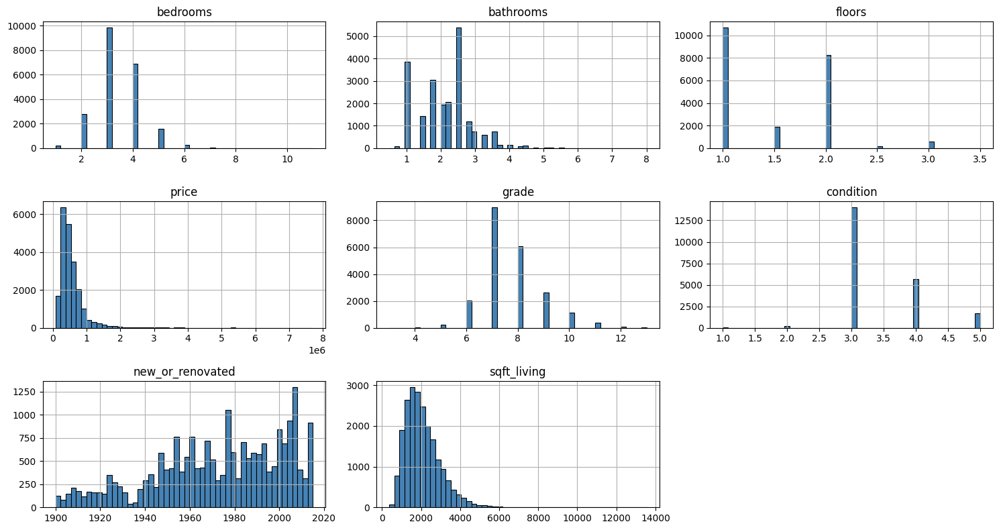

In [48]:
original[hist_columns].hist(bins=50, figsize = (15,8), linewidth = 0.8,edgecolor = "black",color="steelblue")
plt.tight_layout()
plt.show()

- Most houses have 2 or more bedrooms
- Most houses also have 2 or more bathrooms
- Almost all houses have 2 or less floors. There are only very few with more than 2 floors
- The price is heavily right skewed which shows us that there are fewer very expensive houses.
- Our grade scale is from 1 to 13 and most of the houses in this dataset are within the range between 6 and 9. 
- There are almost no houses in poor condition. Almost all houses are at 2 or above. 
- The number of renovations and newly built houses increased throughout the time. So most of the houses should be in a good state
- Most houses have 1000 to 3000 sqft 

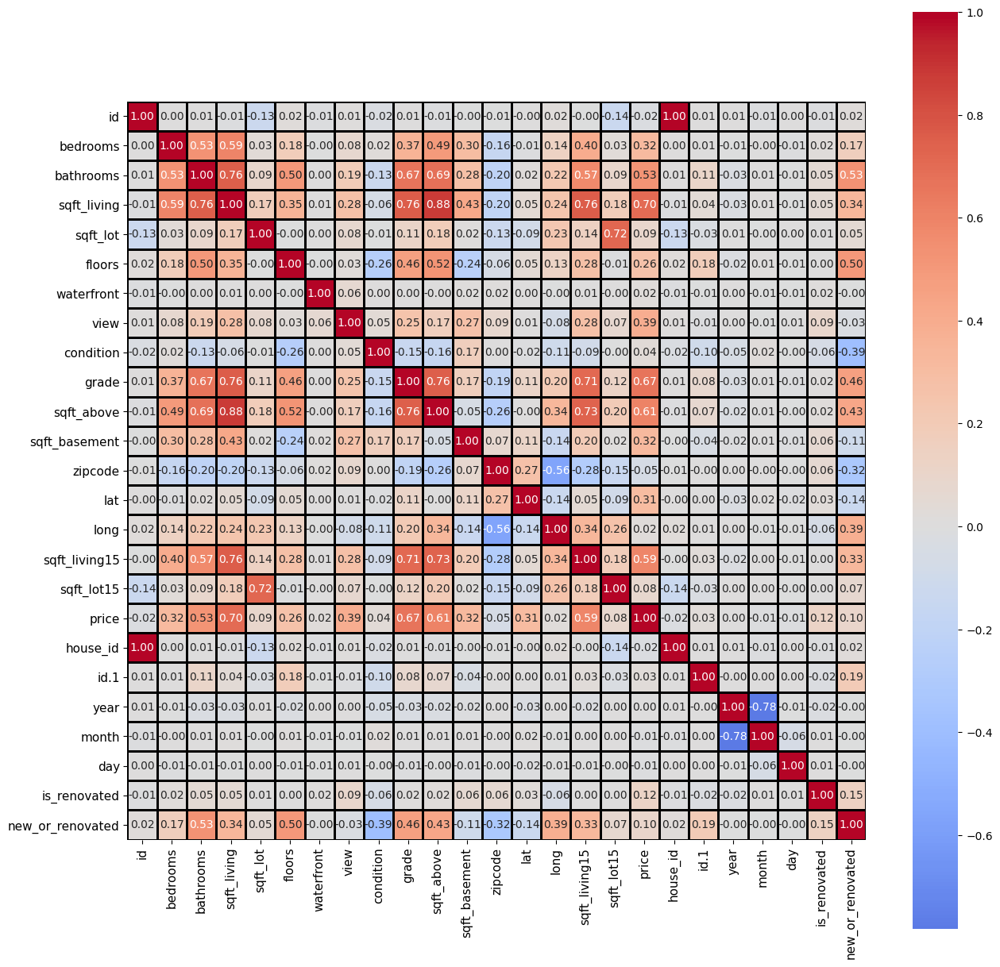

In [49]:
corr_matrix = original.corr()

# plot correlation matrix
plt.figure(figsize=(15, 15))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', center=0, linewidths=1, linecolor='black', fmt='.2f', square=True, cbar=True, annot_kws={"size": 10})
plt.xticks(fontsize=11)
plt.yticks(fontsize=11)
plt.show()

We narrow this down to the columns which correlate to each other at minimum 0.5

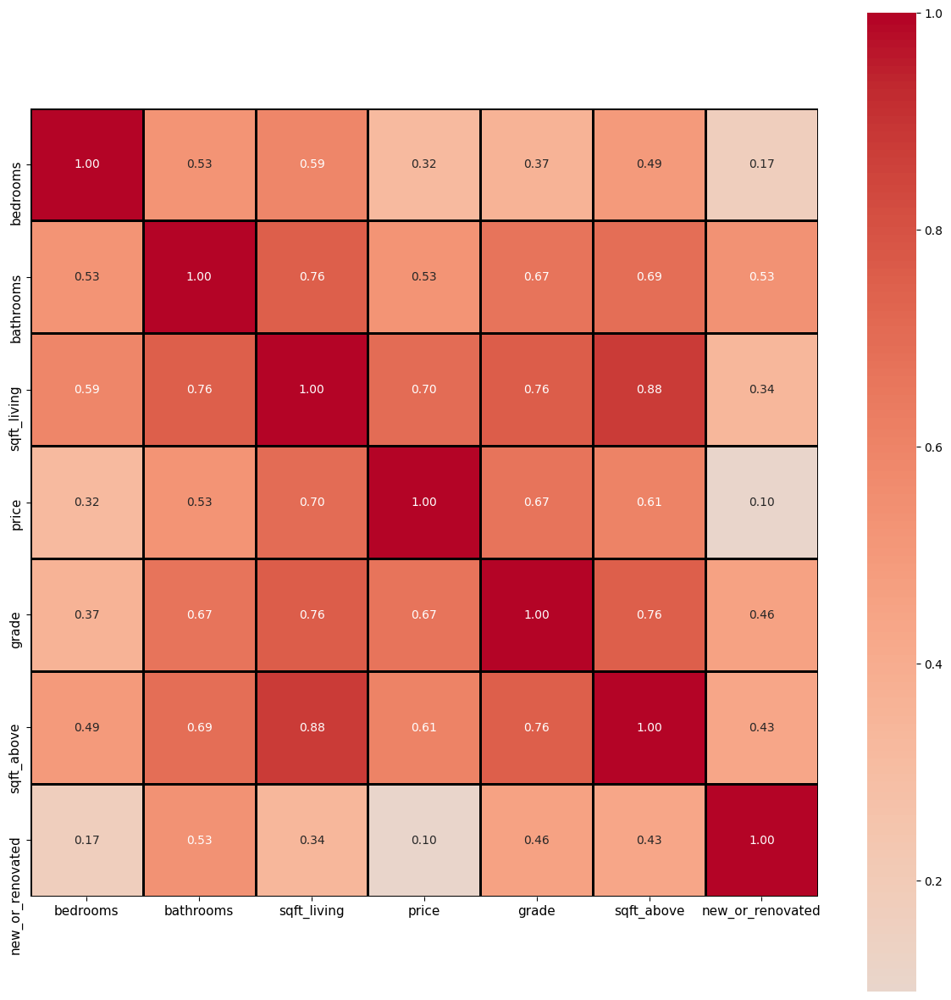

In [50]:

columns_to_include = ["bedrooms", "bathrooms", "sqft_living", "price", "grade", "sqft_above", "new_or_renovated"]
corr_matrix = original[columns_to_include].corr()

# plot correlation matrix
plt.figure(figsize=(15, 15))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', center=0, linewidths=1, linecolor='black', fmt='.2f', square=True, cbar=True, annot_kws={"size": 10})
plt.xticks(fontsize=11)
plt.yticks(fontsize=11)
plt.show()


**Correlations above 0.5**

Most interesting correlations are those who correlate with the price, the grade, and if ite newor renovated.
Which factors influence the price:
- The price correlates higher with the number of bathrooms than with the number of bedrooms which is strange for my understanding.
- The price correlates highly with the sqft_living and the grade 

The larger the living area the larger the squarefeet above.
The bigger the squarefeet above the higher the grade. 

When a building has been renovated it was mostly about bathrooms. Those correlate with each other. A new or newly renovated building also tend to get higher ratings. 

## **Findings that meet our goals**


**Lets reduce our dataset to meet the needs of our stakeholder**

**recap our goals**
- waterfront is a must have
- it should be build or renovated recently (the latest possible year)
- have a grade above 8 since 75% of the houses are below or equal to 8
- has to be viewed with 4
- has to be in condition of 4 or 5

## Hypothesis

Does the location of the house influence the price?
- The closer to the center of the city the higher the price.
- Houses with waterfront are more expensive

Does the size of the living area influence the price?
- The more living area the higher the price.
- the more bedrooms the higher the price. 

Does the location influence the grades of a house?
- If a house is within a certain region it is beeing rated higher than in other regions

- Newly build or renovated buildings only appear in the expensive areas in the city.

**1. The closer to the center of the city the higher the price**

We need to print a heatmap on the map itself to determine where the expensive regions are.
Therefore we create the column price_per_sqft_living.

In [51]:
original = original.eval("price_per_sqft_living = price/(sqft_living + sqft_lot)").round(2)


In [168]:
original.head()

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,zipcode,lat,long,sqft_living15,sqft_lot15,date,price,house_id,id.1,year,month,day,is_renovated,new_or_renovated,quality,price_per_sqft_living
0,7129300520,3.000,1.000,1180.000,5650.000,1.000,2,0,3,7,1180.000,0.000,98178,47.510,-122.260,1340.000,5650.000,2014-10-13,221900.000,7129300520,1,2014,10,13,0,1955,Average,32.490
1,6414100192,3.000,2.250,2570.000,7242.000,2.000,0,0,3,7,2170.000,400.000,98125,47.720,-122.320,1690.000,7639.000,2014-12-09,538000.000,6414100192,2,2014,12,9,1,1991,Average,54.830
2,5631500400,2.000,1.000,770.000,10000.000,1.000,0,0,3,6,770.000,0.000,98028,47.740,-122.230,2720.000,8062.000,2015-02-25,180000.000,5631500400,3,2015,2,25,0,1933,Average,16.710
3,2487200875,4.000,3.000,1960.000,5000.000,1.000,0,0,5,7,1050.000,910.000,98136,47.520,-122.390,1360.000,5000.000,2014-12-09,604000.000,2487200875,4,2014,12,9,0,1965,Average,86.780
4,1954400510,3.000,2.000,1680.000,8080.000,1.000,0,0,3,8,1680.000,0.000,98074,47.620,-122.040,1800.000,7503.000,2015-02-18,510000.000,1954400510,5,2015,2,18,0,1987,Average,52.250


In [191]:
# creating a DataFrame with the average price_per_sqft_living grouped by zipcode for mapping to get a better overview
original_zipcode = original.groupby("zipcode").mean().sort_values("price_per_sqft_living").reset_index()
# import new data to get the district name for every zip code
zip_name= pd.read_excel("data/zip_code_names.xlsx")
# join the new original to the zipcode original
original_zipcode = pd.merge(zip_name,original_zipcode,how="inner",on="zipcode")
# check if everything works
original_zipcode.head()

,zipcode,city,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,lat,long,sqft_living15,sqft_lot15,price,house_id,id.1,year,month,day,is_renovated,new_or_renovated,price_per_sqft_living
0,98001,Algona,4651273623.072,3.393,2.012,1903.784,14967.003,1.431,0.183,0.094,3.335,7.296,1723.756,180.028,47.309,-122.270,1830.100,11218.875,281194.870,4651273623.072,11353.100,2014.321,6.568,16.471,0.011,1981.371,24.089
1,98001,Auburn,4651273623.072,3.393,2.012,1903.784,14967.003,1.431,0.183,0.094,3.335,7.296,1723.756,180.028,47.309,-122.270,1830.100,11218.875,281194.870,4651273623.072,11353.100,2014.321,6.568,16.471,0.011,1981.371,24.089
2,98001,Federal Way,4651273623.072,3.393,2.012,1903.784,14967.003,1.431,0.183,0.094,3.335,7.296,1723.756,180.028,47.309,-122.270,1830.100,11218.875,281194.870,4651273623.072,11353.100,2014.321,6.568,16.471,0.011,1981.371,24.089
3,98002,Auburn,4850894131.724,3.327,1.839,1627.744,7517.633,1.334,0.201,0.010,3.744,6.693,1522.538,105.206,47.309,-122.214,1479.030,7585.482,234284.035,4850894131.724,11381.719,2014.337,6.698,16.834,0.025,1968.925,28.499
4,98003,Auburn,4674181960.679,3.357,2.047,1928.882,10603.096,1.311,0.179,0.214,3.371,7.543,1663.550,259.118,47.316,-122.309,1876.196,9746.179,294111.279,4674181960.679,10250.086,2014.343,6.621,16.000,0.007,1977.257,26.225


connect the zipcodes to the areas to create the map.

In [192]:
# load the geojson for mapping 
with open("data/Zipcodes_for_King_County_and_Surrounding_Area___zipcode_area.geojson") as f:
    gj = geojson.load(f)
# To look what we want to get for the mapping we need only the zipcodes from the geojson
gj["features"][0]["properties"]["ZIPCODE"]
# loop through the geojson to get the zipcodes
for i in range(len(gj["features"])):
    gj["features"][i]["id"] = gj["features"][i]["properties"]["ZIPCODE"]

Create a map.

In [228]:
# Build a geoplot to show the cheap and expensive area in King county
fig = px.choropleth_mapbox(original_zipcode, geojson=gj, locations="zipcode", color="price_per_sqft_living",
                           color_continuous_scale='bluered',
                           range_color=(0,250),
                           mapbox_style="carto-positron",
                           zoom=8, center={"lat": 47.373348, "lon": -122.036926},
                           opacity=0.5, 
                           labels={'price_per_sqft_living':'Price per square foot of living'},
                           hover_name="city")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.update_geos(fitbounds="locations", visible=False,center={"lat": 47.47, "lon": 47.47 -121.84})
fig.show()

We can see, that the price per sqft living is higher in the center of seattle than in the border regions. 
The most expensive areas in Seattle are the zipcodes: 98119, 98109, 98102, and 98112. The price per sqft is above 150 $.
This is the region we should probably look at for our stakeholder.


**2. Houses with Waterfront are more expensive**

We filter our houses by those ones who have no information about the waterfront.

In [230]:
original_water = original.query('waterfront != 0')

In [231]:
fig = px.choropleth_mapbox(original_zipcode, geojson=gj, locations="zipcode", color="price_per_sqft_living",
                           color_continuous_scale=px.colors.sequential.Inferno,
                           range_color=(0,250),
                           mapbox_style="carto-positron",
                           zoom=8, center={"lat": 47.373348, "lon": -122.036926},
                           opacity=0.5, 
                           labels={'price_per_sqft_living':'Price per square foot of living'},
                           hover_name="city")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.update_geos(fitbounds="locations", visible=False,center={"lat": 47.47, "lon": 47.47 -121.84})
scatter_trace = go.Scattermapbox(
    lat=original_water['lat'], 
    lon=original_water['long'],
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=4,
        color='Black'
    ),
    hovertext=original_water['price_per_sqft_living']
)

fig.add_trace(scatter_trace)
fig.show()

We can see, that there are lots of houses in areas where you can have a waterfront. So we will take those also in consideration. Therefore we will filter our dataset by the houses which have a waterfront and those who are uncertain. Since there is also a chance of it having a waterfront. (We would have to check for each selection)

Houses which are marked as not having a waterfront, also find to have waterfronts. That information is not valuable. We will not take that into consideration.

Houses with a waterfront are not neccessaryly more expensive. The houses in Vashon (98070) are way cheaper than the houses in Seattle (98109) for example. Since the waterfront is no reliable value and 

**We have our houses which have a waterfront. But it is still pretty overwhelming information. We need to consider more wishes from our stakeholder.**

**3. The higher the living area the higher the price**

We will use a scatter plot to do so.

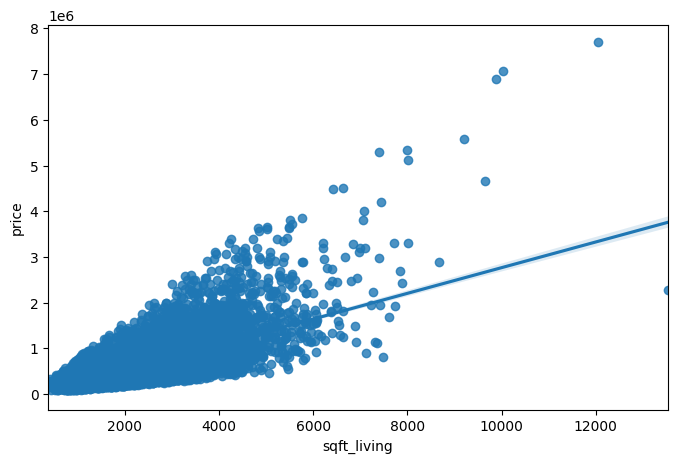

In [94]:
# create scatterplot
sns.regplot(x='sqft_living', y='price', data=original)

# show plot
plt.show()

We can see that the living area has an impact on the price. As to be expected but the impact is not as high as we would have thought.

**4. The more bedrooms the higher the price**

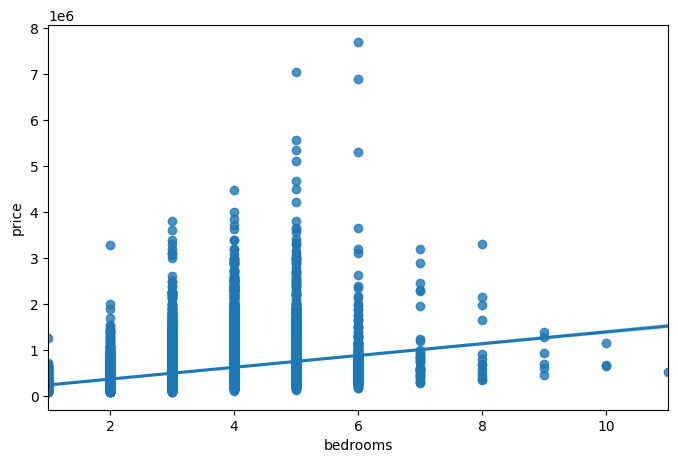

In [95]:
# create scatterplot
sns.regplot(x='bedrooms', y='price', data=original)

# show plot
plt.show()

The number of bedrooms seem not to have a high impact on thr price. Since an increase of the living area also causes an increase of the price, we would have thought, that the increase of bedrooms would increase the price similarly. But it has a way less impact.

**5. Rating in several areas are higher than in other areas**

In [237]:

fig = px.choropleth_mapbox(original_zipcode, geojson=gj, locations="zipcode", color="grade",
                           color_continuous_scale=px.colors.sequential.Inferno,
                           range_color=(0,13),
                           mapbox_style="carto-positron",
                           zoom=8, center={"lat": 47.373348, "lon": -122.036926},
                           opacity=0.7, 
                           labels={'grade':'Grade'},
                           hover_name="city")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.update_geos(fitbounds="locations", visible=True, center={"lat": 47.47, "lon": 47.47 -121.84})
fig.show()

The average grade is very similar throughout the whole region. 

The areas with the highest average rating are Medina (98039), Mercer Island (98040), Issaquah (98075), Yarrow Point (98004), Redmond (98074), Bellevue (98006)

**6. Newly build or renovated houses are in a certain area**

In [232]:
original_water_renov = water.query('is_renovated == 1')


In [233]:
original_water_renov_zip = original_water_renov.merge(zip_name,how="inner")


In [234]:
original_water_renov['quality'].value_counts()

Average    113
High         8
Low          0
Name: quality, dtype: int64

In [235]:
fig = px.scatter_mapbox(original_water_renov, lat="lat", lon="long",
                  color_continuous_scale="bluered", 
                  size_max=10, zoom=8, 
                  color="price", size="price",
                  hover_name='id')
fig.update_layout(mapbox_style="open-street-map",title="Houses with Water view and renovated",title_font_size= 30)
fig.show()

**We have the houses with waterfront which are newly renovated (or built). Now we need to get the quality of our houses we are looking for. It needs to be high to meet the needs of our stakeholder. So lets filter our dataset further down.

In [239]:
high = original_water_renov.query('quality == "High"')

In [240]:
fig = px.scatter_mapbox(high, lat="lat", lon="long",
                  color_continuous_scale="bluered", 
                  size_max=10, zoom=8, 
                  color="price", size="price",
                  hover_name='id')
fig.update_layout(mapbox_style="open-street-map",title="Houses with Water view and renovated",title_font_size= 30)
fig.show()

In [245]:
final = high['id'].tolist()
final

[5486800070,
 9808700762,
 1924059029,
 6117502230,
 3025300095,
 46100504,
 8106100085,
 3625059152]

In [246]:
high.head(10)

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,zipcode,lat,long,sqft_living15,sqft_lot15,date,price,house_id,id.1,year,month,day,is_renovated,new_or_renovated,quality,price_per_sqft_living
556,5486800070,7.000,3.500,4640.000,15235.000,2.000,2,1,3,11,2860.000,1780.000,98040,47.570,-122.230,3230.000,20697.000,2014-06-20,1950000.000,5486800070,557,2014,6,20,1,2003,High,98.110
3910,9808700762,5.000,4.500,10040.000,37325.000,2.000,1,2,3,11,7680.000,2360.000,98004,47.650,-122.210,3930.000,25449.000,2014-06-11,7060000.000,9808700762,3911,2014,6,11,1,2001,High,149.060
8085,1924059029,5.000,6.750,9640.000,13068.000,1.000,1,4,3,12,4820.000,4820.000,98040,47.560,-122.210,3270.000,10454.000,2014-06-17,4670000.000,1924059029,8086,2014,6,17,1,2009,High,205.650
15678,6117502230,3.000,3.500,4660.000,21164.000,2.000,1,4,3,12,4660.000,0.000,98166,47.440,-122.350,3140.000,24274.000,2014-12-01,1640000.000,6117502230,15679,2014,12,1,1,1990,High,63.510
16811,3025300095,4.000,4.500,4300.000,19844.000,2.000,2,0,3,11,4300.000,0.000,98039,47.620,-122.240,3070.000,19845.000,2014-10-09,2500000.000,3025300095,16812,2014,10,9,1,1999,High,103.550
17966,46100504,4.000,3.750,4100.000,22798.000,1.500,2,3,5,11,2540.000,1560.000,98040,47.560,-122.210,3880.000,18730.000,2014-06-17,2030000.000,46100504,17967,2014,6,17,1,1979,High,75.470
18132,8106100085,5.000,4.500,5190.000,23716.000,2.000,2,2,3,11,3390.000,1800.000,98040,47.580,-122.220,4460.000,22748.000,2014-05-09,1700000.000,8106100085,18133,2014,5,9,1,2000,High,58.810
18185,3625059152,3.000,3.250,4220.000,41300.000,1.000,1,4,4,11,2460.000,1760.000,98008,47.610,-122.110,3810.000,30401.000,2014-12-30,3300000.000,3625059152,18186,2014,12,30,1,1987,High,72.500
